In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import numpy as np
import torch
import torch.utils.data as data
import torch.nn as nn
import os
import random
import torchvision
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt
from torch.utils.data.sampler import SubsetRandomSampler
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
from torchvision.utils import save_image
from PIL import Image

In [ ]:
USE_COLAB = True
if USE_COLAB:
    # mount the goole drive
    from google.colab import drive
    drive.mount('/content/drive')
    data_dir = "/content/drive/My Drive/Colab Notebooks/wafer"


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


######讀取npy檔以及後續tensor處理動作


In [ ]:
data_th = np.load(os.path.join(data_dir, "data.npy"))
label_th = np.load(os.path.join(data_dir, "label.npy"))
data_5th=[]
label_5th=[]
train_data=[]
for i in range(len(data_th)):
  train_data.append([data_th[i],label_th[i]])
  channelloader = torch.utils.data.DataLoader(train_data,batch_size=1281,num_workers=0) #將data和label儲存再一起

data_th=data_th.reshape(1281,3,26,26)

for i in range(5):#將dataset讀入資料集變為5倍
  data_5th.extend(data_th)
  label_5th.extend(label_th)

data_5th=np.array(data_5th)
label_5th=np.array(label_5th)

In [ ]:
num_workers = 0
# how many samples per batch to load
batch_size = 61
batch_size1 = 61

print(data_th.shape)
print(label_th.shape)
print(data_5th.shape)
print(label_5th.shape)

image_tensor=torch.Tensor(data_th)
label_tensor = torch.Tensor(label_th)
dataset = torch.utils.data.TensorDataset(image_tensor,label_tensor)
torch.manual_seed(30)
dataloader = torch.utils.data.DataLoader(dataset,batch_size=batch_size,shuffle=True) #將data和label儲存再一起
dataloader1 = torch.utils.data.DataLoader(label_th,batch_size=batch_size,num_workers=num_workers)

image_tensor1=torch.Tensor(data_5th)
label_tensor1 = torch.Tensor(label_5th)
dataset1 = torch.utils.data.TensorDataset(image_tensor,label_tensor)
reconstructloader = torch.utils.data.DataLoader(dataset1,batch_size=batch_size1,num_workers=num_workers)
reconstructloader1 = torch.utils.data.DataLoader(label_5th,batch_size=batch_size,num_workers=num_workers)


(1281, 3, 26, 26)
(1281, 1)
(6405, 3, 26, 26)
(6405, 1)


######圖片讀取方式以及label定義

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline

# helper function to un-normalize and display an image
def imshow(img):
    img = img / 2 + 0.5  # unnormalize
    plt.imshow(np.transpose(img, (0, 1, 2)))  
def imshow2(img):
    img = img.reshape(26,26,3) 
    img = img / 2 + 0.5  # unnormalize
    plt.imshow(img) 
    
# specify the image classes
classes = ['Center(0)', 'Dount(1)', 'Edge-Loc(2)', 'Edge-Ring(3)', 'Loc(4)',
           'Near-full(5)', 'Random(6)', 'Scratch(7)', 'None(8)']


######原始生成的資料集


In [ ]:
dataiter1 = iter(dataloader1)
labels = dataiter1.next()#origin的資料集
dataiter = iter(dataloader)
images,test= dataiter.next()#origin的資料集
images = images.numpy() # convert images to numpy for display


######五張生成sample的資料集


In [ ]:
dataiter2 = iter(reconstructloader1)
labels1 = dataiter2.next()#origin的資料集
dataiter1 = iter(reconstructloader)
images1,test2= dataiter1.next()#reconstruct的資料集
images1=images1.numpy()

######測試三個channel狀況的資料集


In [ ]:
dataiterchannel = iter(channelloader)
imagetest,labeltest = dataiterchannel.next()#origin的資料集
imagetest=imagetest.numpy()

######呈現簡單圖檔和label,確認是否有將檔案讀取

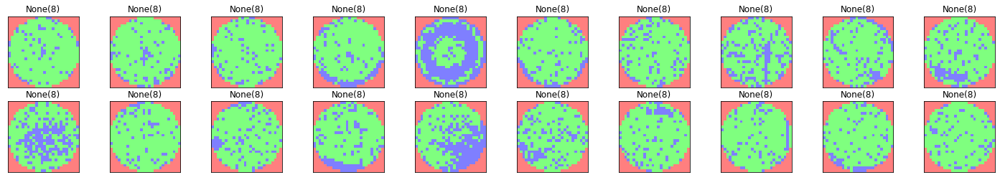

In [ ]:
# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(25, 4))
# display 20 images
for idx in range(20):
    ax = fig.add_subplot(2, 10, idx+1, xticks=[], yticks=[])#subplot行數,subplot列數,每張圖顯示
    imshow2(images[idx])
    ax.set_title(classes[labels[idx]])

######測試三個channel的輸出狀況,分別看圖片boundary,defect,normal

(1281, 3, 26, 26)


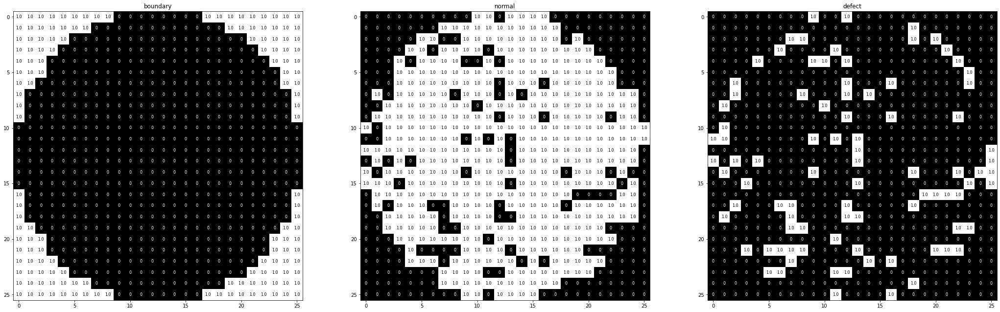

In [ ]:
new_image=np.transpose(imagetest, (0, 3, 2, 1))
print(new_image.shape)
wafer_img = np.squeeze(new_image[3])#去掉陣列中第1維度(從0開始定軸)
channels = ['boundary', 'normal', 'defect']

fig = plt.figure(figsize = (36, 36)) 
for idx in np.arange(wafer_img.shape[0]):
    ax = fig.add_subplot(1, 3, idx + 1)
    img = wafer_img[idx]
    ax.imshow(img, cmap='gray')
    ax.set_title(channels[idx])
    width, height = img.shape
    thresh = img.max()/2.5
    for x in range(width):
        for y in range(height):
            val = round(img[x][y], 2) if img[x][y] !=0 else 0
            ax.annotate(str(val), xy=(y,x),
                    horizontalalignment='center',
                    verticalalignment='center', size=8,
                    color='white' if img[x][y]<thresh else 'black')

### Convolutional Autoencoder


*   Encoder-The encoder part of the network will be a typical convolutional pyramid. Each convolutional layer will be followed by a max-pooling layer to reduce the dimensions of the layers
*   Decoder-The decoder needs to convert from a narrow representation to a wide, reconstructed image.



In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

# define the NN architecture
#Conv2D:(inputsize-kernel+2*padding)/stride+1
#ConvTranspose2d:(inputsize-1)*stride+kernel-2*padding+outpadding
class ConvAutoencoder(nn.Module):
    def __init__(self):
        super(ConvAutoencoder, self).__init__()
        ## encoder layers ##
        # conv layer (depth from 3 --> 16), 3x3 kernels
        self.conv1 = nn.Conv2d(3, 16, 3, stride=2, padding=1)
        # conv layer (depth from 16 -->32), 3x3 kernels
        self.conv2 =  nn.Conv2d(16, 32, 3, stride=2, padding=1)
        # conv layer (depth from 32 -->64), 5x5 kernels
        self.conv3 =  nn.Conv2d(32, 64, 5)
        
        ## decoder layes ##
        # tconv layer (depth from 64 --> 32), 5x5 kernels
        self.t_conv1 =  nn.ConvTranspose2d(64, 32, 5)
        # tconv layer (depth from 32 --> 16), 3x3 kernels
        self.t_conv2 = nn.ConvTranspose2d(32, 16, 3, stride=2, padding=1, output_padding=1)
        # tconv layer (depth from 16 --> 3), 3x3 kernels
        self.t_conv3 = nn.ConvTranspose2d(16, 3, 3, stride=2, padding=2, output_padding=1)


    def forward(self, x):
        
       ## encode ##
        # add hidden layers with relu activation function
        # add first hidden layer
        x = F.relu(self.conv1(x))  
        
        # add second hidden layer
        x = F.relu(self.conv2(x))
        
        x = self.conv3(x)
        
        
         
        ## decode ##
        # add transpose conv layers, with relu activation function
        x = F.relu(self.t_conv1(x)) 
        x = F.relu(self.t_conv2(x)) 
        # output layer (with sigmoid for scaling from 0 to 1)
        x = F.sigmoid(self.t_conv3(x)) 
        return x

# initialize the NN
model = ConvAutoencoder()
print(model)

ConvAutoencoder(
  (conv1): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv3): Conv2d(32, 64, kernel_size=(5, 5), stride=(1, 1))
  (t_conv1): ConvTranspose2d(64, 32, kernel_size=(5, 5), stride=(1, 1))
  (t_conv2): ConvTranspose2d(32, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
  (t_conv3): ConvTranspose2d(16, 3, kernel_size=(3, 3), stride=(2, 2), padding=(2, 2), output_padding=(1, 1))
)


In [ ]:
def add_noise(inputs,i):
     noise = torch.randn_like(inputs)*(i/10)
     return inputs + noise

In [ ]:
# specify loss function
criterion = nn.MSELoss()
# specify loss function
optimizer = torch.optim.Adam(model.parameters(), lr=0.001,weight_decay=1e-5)


######Gaussian noise


#####enable the CUDA environment.

In [ ]:
use_gpu = True
device = torch.device("cuda:0" if use_gpu and torch.cuda.is_available() else "cpu")
model = model.to(device)

######create a directory to save the results.

In [ ]:
def make_dir():
    image_dir = 'Wafer_Out_Images'
    if not os.path.exists(image_dir):
        os.makedirs(image_dir)

######save the reconstructed images as generated by the model.

In [ ]:
def save_decod_img(img, epoch):
    img = img.view(img.size(0), 3, 26, 26)
    save_image(img, '/content/drive/My Drive/Colab Notebooks/Wafer_Out_Images/Autoencoder_image{}.png'.format(epoch))

######計算1281張圖的reconstruction loss

Epoch 100
reconstruction Train Loss: 0.03159319325571969


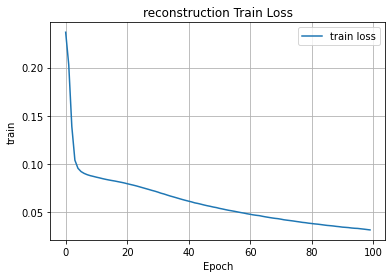

In [ ]:
from numpy import double
from IPython.display import clear_output
# number of epochs to train the model
n_epochs = 100
train_loss_log=[]


for epoch in range(1, n_epochs+1):
    # monitor training loss
    train_loss = 0.0
    
    ###################
    # train the model #
    ###################
    for data in dataloader:
        # _ stands in for labels, here
        # no need to flatten images
        image_test, _ = data
        

        #add the gaussian noise to input
        
        # new_image1=np.reshape(image_test, (1281, 3, 26, 26))
        # noise_image=add_noise(new_image1,0.2)#add gaussian noise into latent code
        # forward pass: compute predicted outputs by passing inputs to the model
        outputs = model(image_test)#output is reconstruction image
             
        # calculate the loss
        loss = criterion(outputs, image_test)#calculate the reconstruction image and original image
        # clear the gradients of all optimized variables
        optimizer.zero_grad()
        # backward pass: compute gradient of the loss with respect to model parameters
        loss.backward()
        # perform a single optimization step (parameter update)
        optimizer.step()
        train_loss += loss.item()
        # update running training loss
        # train_loss += loss.item()*new_image1.size(0)
        # save_decod_img(outputs.cpu().data, epoch)
    clear_output()       
   # print avg training statistics 
    train_loss = train_loss/len(dataloader)
    train_loss_log.append(train_loss)
    print("Epoch",epoch)
    print("reconstruction Train Loss:",train_loss_log[-1])
    plt.plot(train_loss_log,label='train loss')
    plt.legend(loc='best')
    plt.title("reconstruction Train Loss")
    plt.xlabel("Epoch")
    plt.ylabel("train")
    plt.grid()
    plt.show()
    
    

######Visualize Original and Reconstructionst

Original images


/usr/local/lib/python3.6/dist-packages/matplotlib/text.py:1165: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if s != self._text:
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1639: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:57: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly cl

Autoencoder reconstruction:


串流輸出內容已截斷至最後 5000 行。
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for 

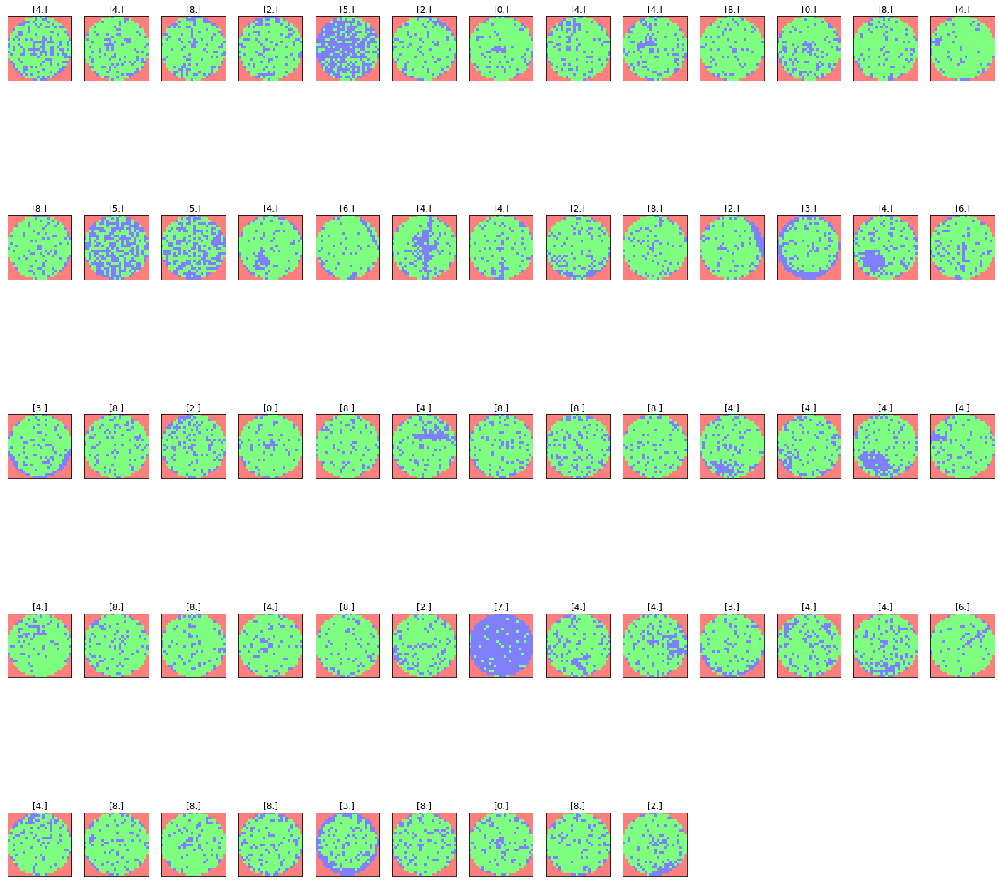

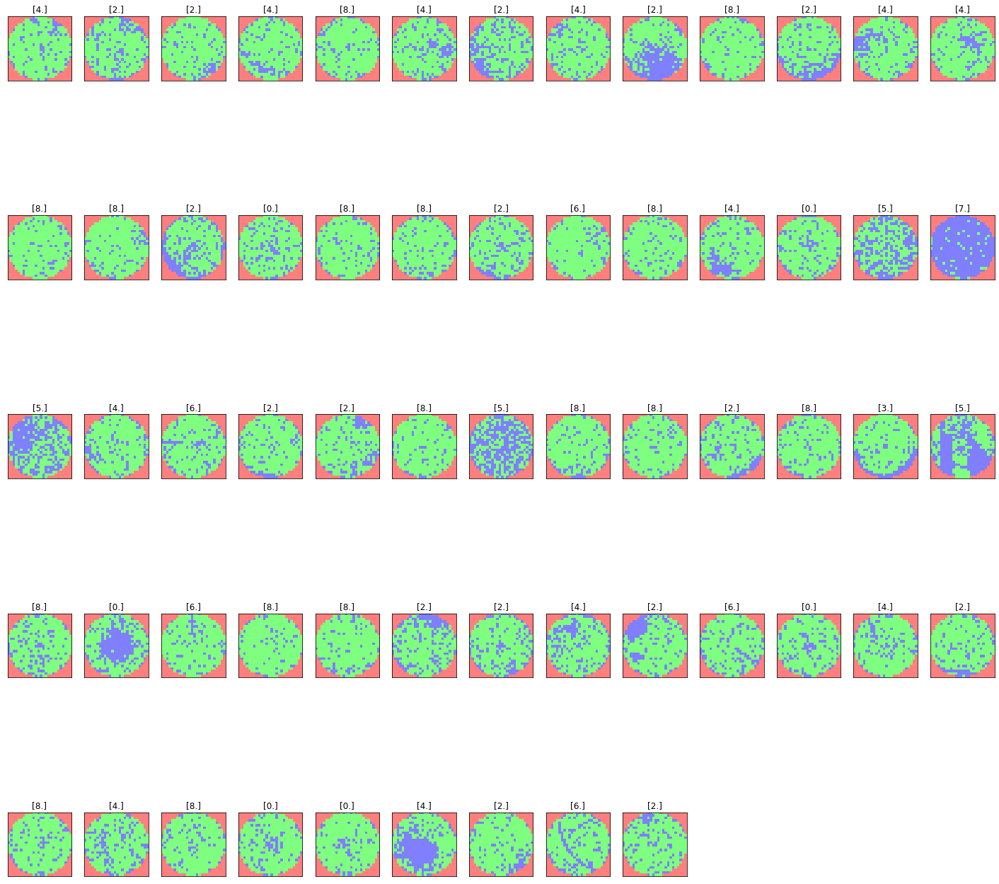

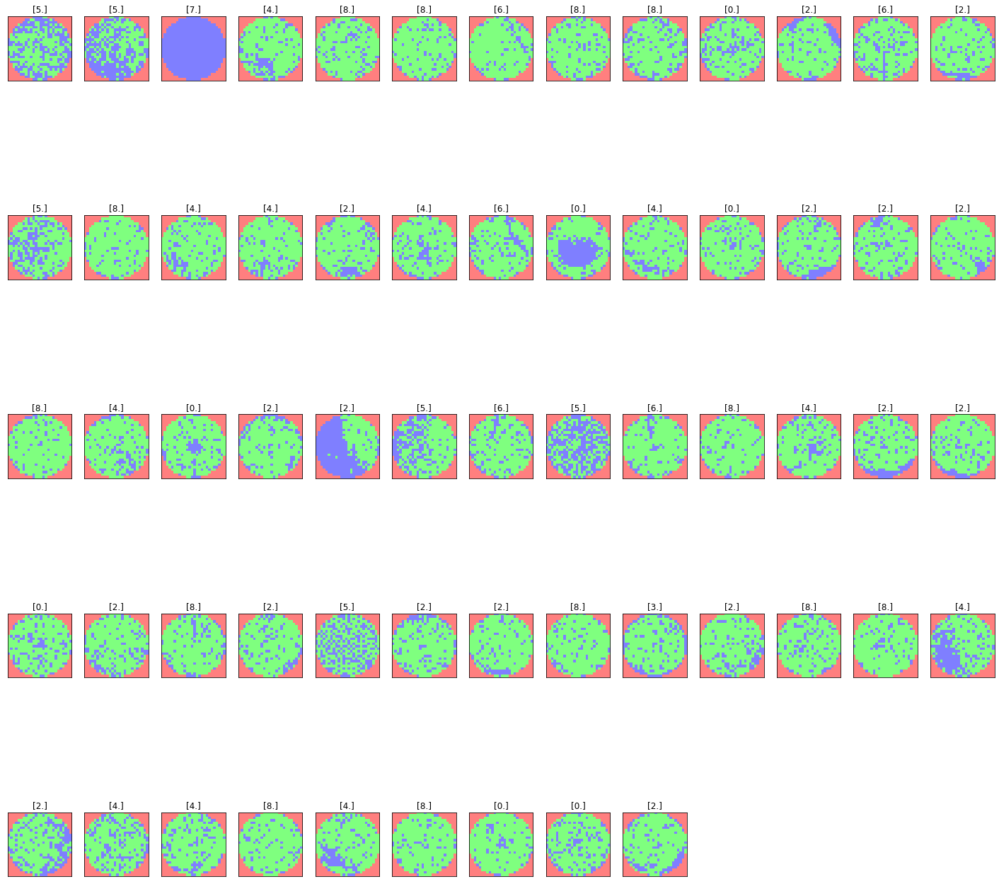

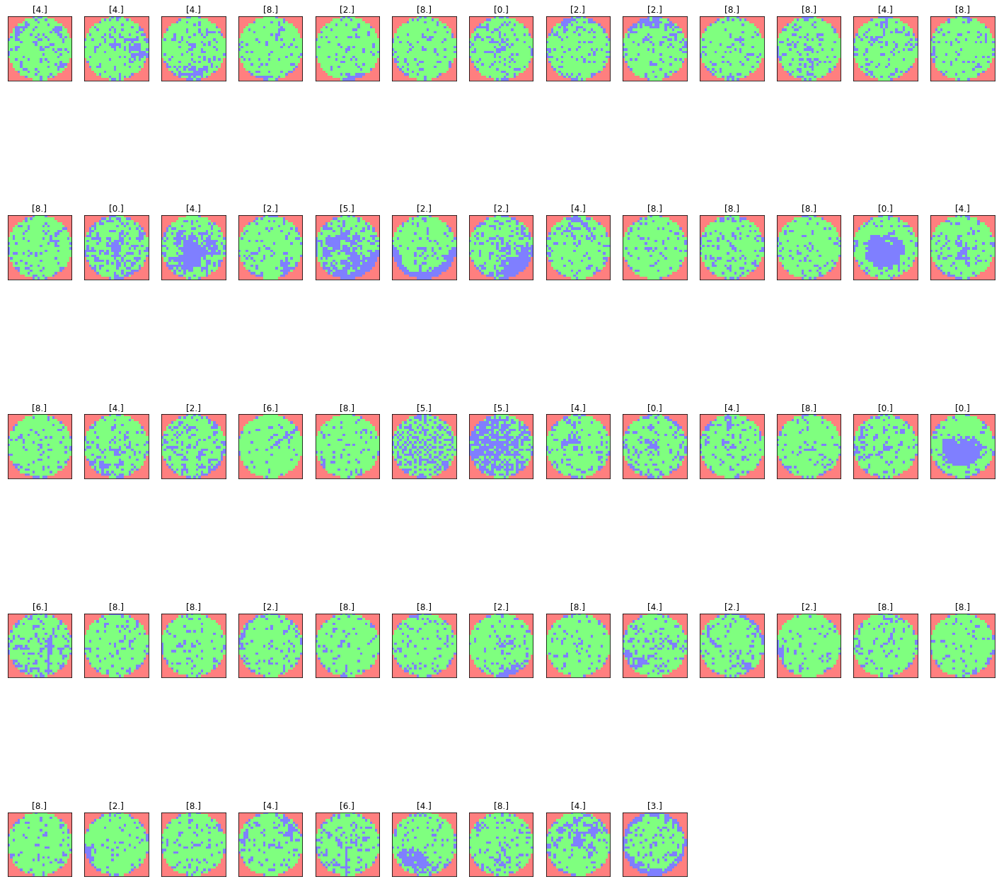

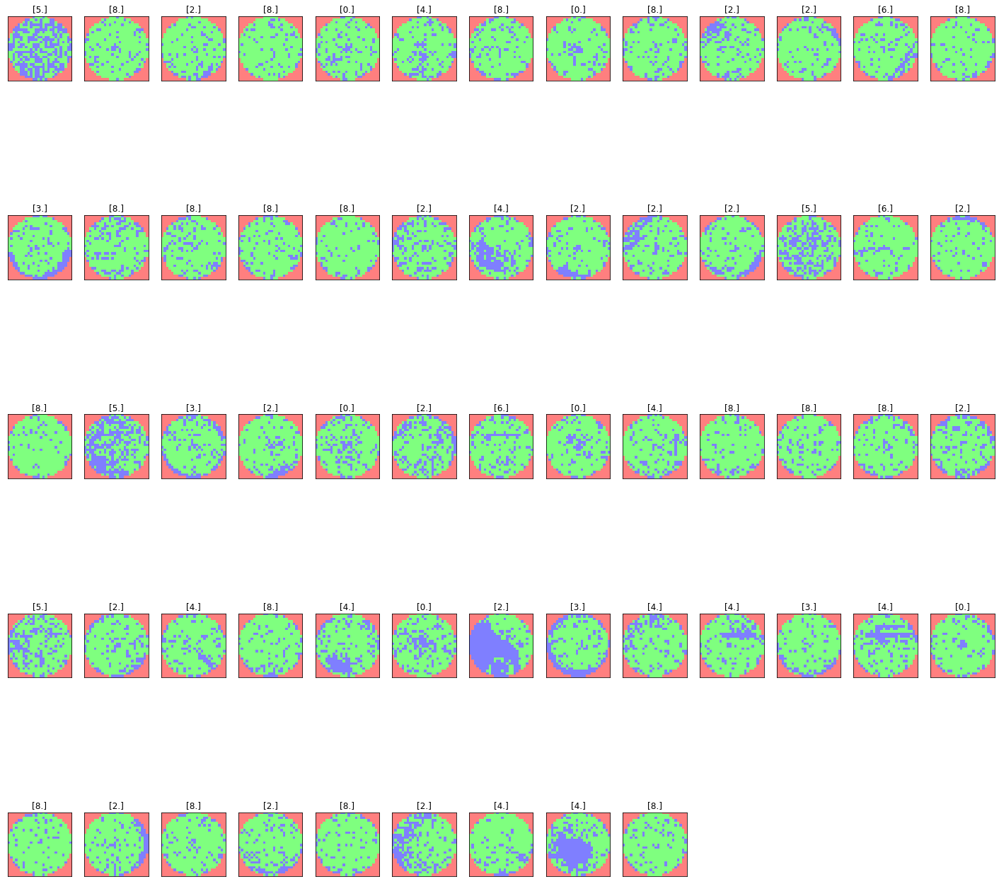

...

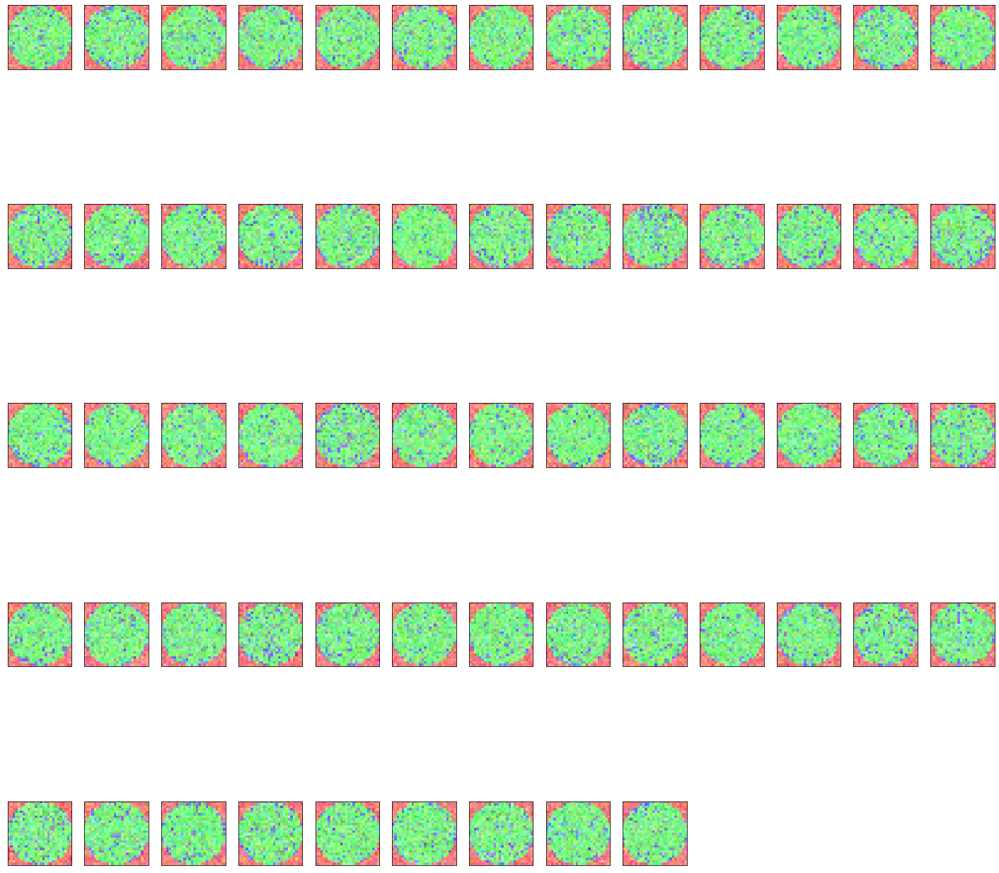

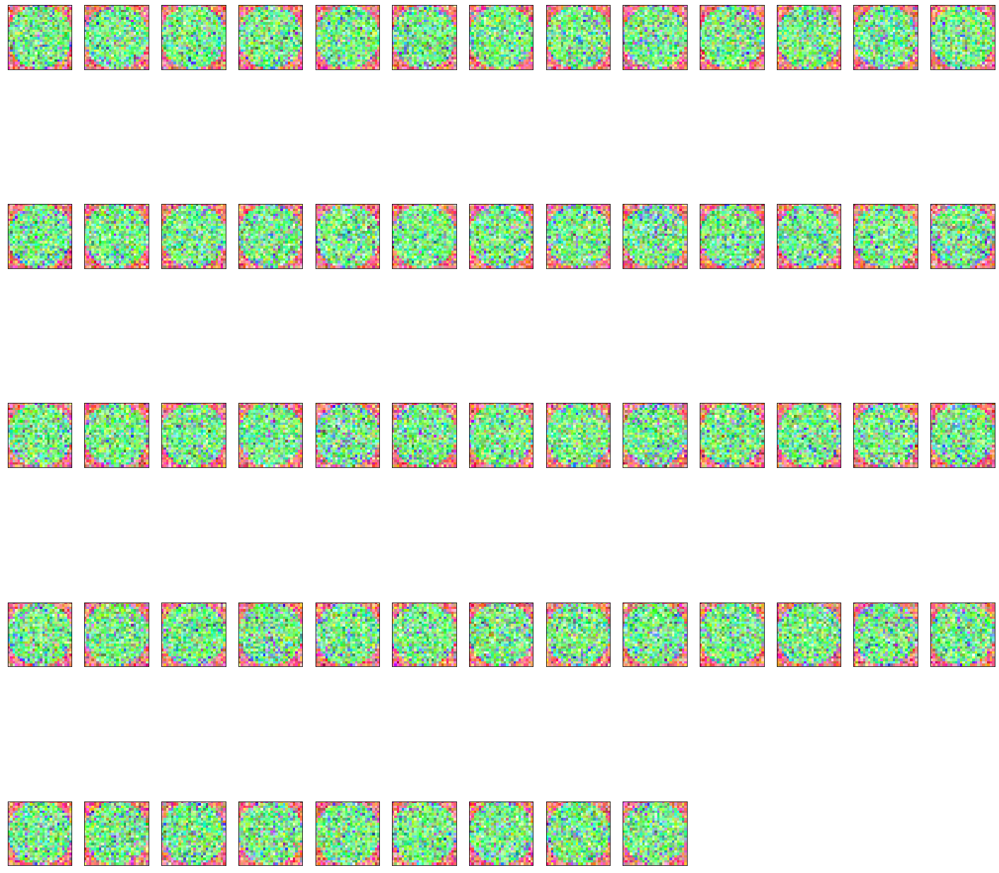

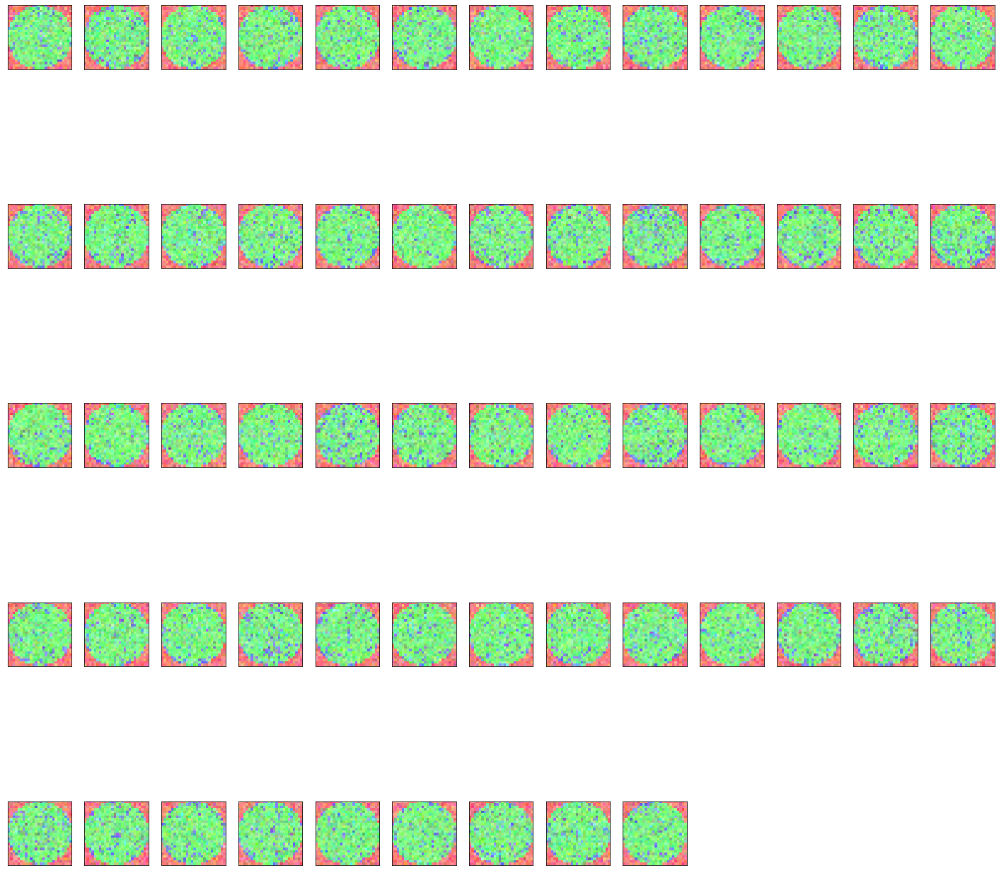

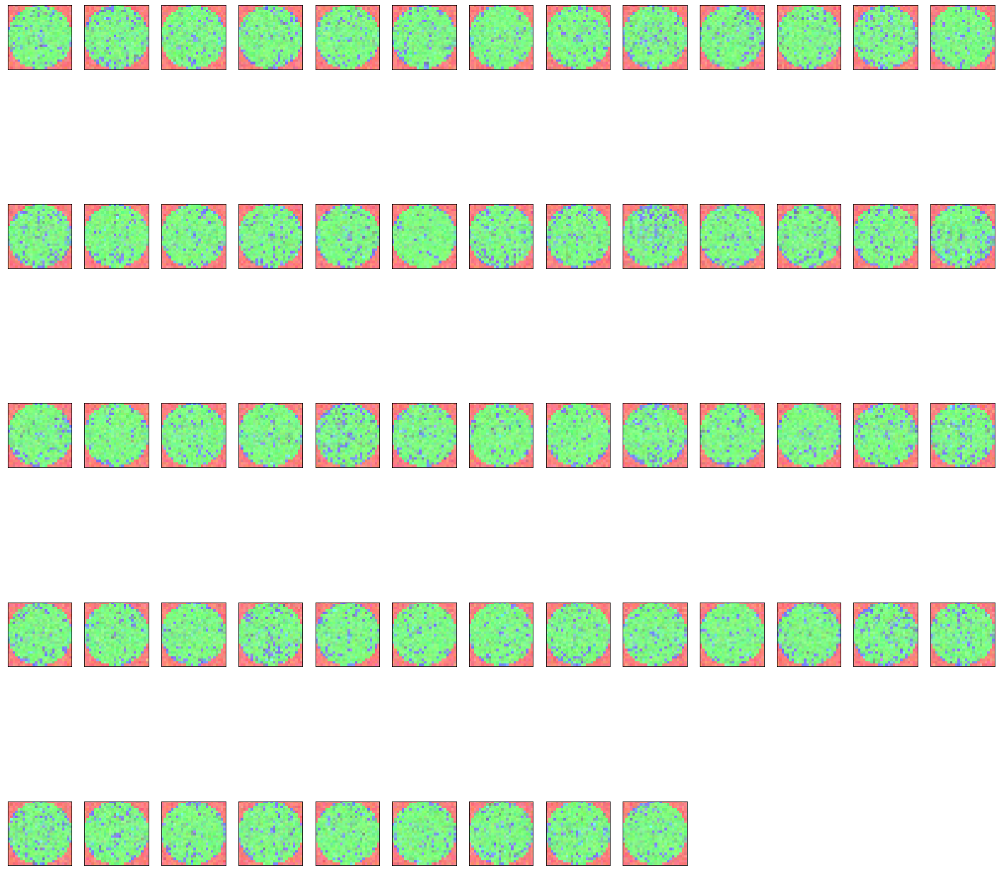

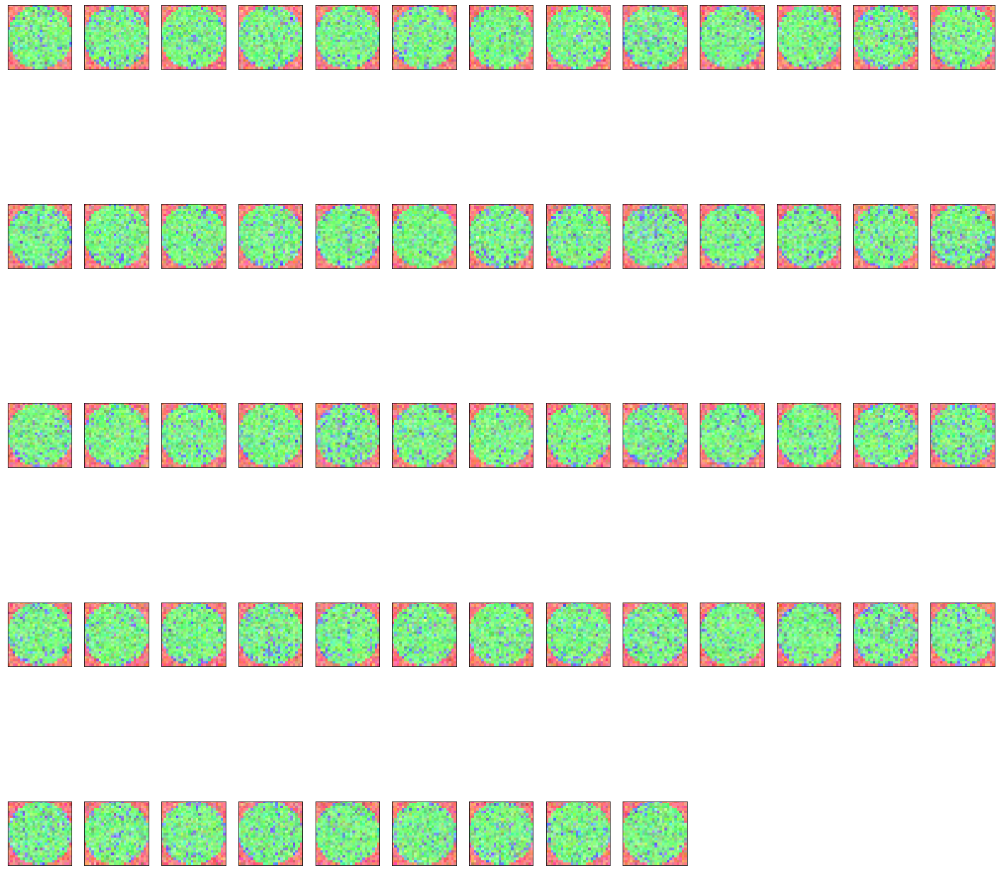

In [109]:
import numpy as np
import matplotlib.pyplot as plt
plt.ion()

import torchvision.utils
image_log=[]
label_log=[]
label_sample_log=[]
image_sample_log=[]



# This function takes as an input the images to reconstruct
# and the name of the model with which the reconstructions
# are performed
def to_img(x):
    x = 0.5 * (x + 1)
    x = x.clamp(0, 1)
    return x

def show_image():# show原本的original wafer圖
  x=0
  while x<(int(1281/61)):
    dataiter = iter(dataloader)
    images,test= dataiter.next()#origin的資料集
    image_display = images.numpy() # convert images to numpy for display
    image_log.append(image_display)
    label_log.append(np.array(test))
    # plot the images in the batch, along with the corresponding labels
    fig = plt.figure(figsize=(25,25))
    
    # display 1281 original images
    for idx in range(61):
      ax = fig.add_subplot(5, 13, idx+1, xticks=[], yticks=[])#subplot行數,subplot列數,每張圖顯示
      imshow2(image_display[idx])
      ax.set_title(np.array(test)[idx])
    
    x=x+1
    
    
   
        
def visualise_output(): # show reconstruct 後的5張 gaussian noise wafer圖
  with torch.no_grad():
    y=0

    while y<(int(6405/61)):
      dataiter1 = iter(reconstructloader)
      images1,test2 = dataiter1.next()#reconstruct的資料集
      images1 = images1.to(device)
      images1 = model(images1)
      images1=add_noise(images1,random.randint(1,5))
      image_display2 = images1.numpy() # convert images to numpy for display
      label_sample_log.append(np.array(test))
      image_sample_log.append(image_display2) 
      # plot the images in the batch, along with the corresponding labels
      fig = plt.figure(figsize=(25,25))
      # display 6405 reconstruct images
      for idx in range(61):
        ax = fig.add_subplot(5, 13, idx+1, xticks=[], yticks=[])#subplot行數,subplot列數,每張圖顯示
        imshow2(image_display2[idx])
     
         
      y=y+1
     


# First visualise the original images
print('Original images')
show_image()

#  Reconstruct and visualise the images using the autoencoder
print('Autoencoder reconstruction:')
visualise_output()

#####存檔

######將reconstruct的6405 個sample檔案存為gen_data.npy檔
######將label class 的6405 個sample檔案存為gen_label.npy檔

In [110]:
# save numpy array as npy file
from numpy import asarray
from numpy import save
save('/content/drive/My Drive/Colab Notebooks/Wafer_Out_data/gen_data.npy',image_sample_log)
save('/content/drive/My Drive/Colab Notebooks/Wafer_Out_data/gen_label.npy',label_sample_log)

######測試 npy讀檔效果

In [111]:
USE_COLAB = True
if USE_COLAB:
    # mount the goole drive
    from google.colab import drive
    drive.mount('/content/drive')
    data_dir = "/content/drive/My Drive/Colab Notebooks/Wafer_Out_data"
data_test = np.load(os.path.join(data_dir, "gen_data.npy"))
label_test = np.load(os.path.join(data_dir, "gen_label.npy"))


print(data_test.shape)
print(label_test.shape)

data_test=data_test.reshape(6405,3,26,26)
label_test=label_test.reshape(6405,1)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
(105, 61, 3, 26, 26)
(105, 61, 1)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
/usr/local/lib/python3.6/dist-packages/matplotlib/text.py:1165: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if s != self._text:
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input dat

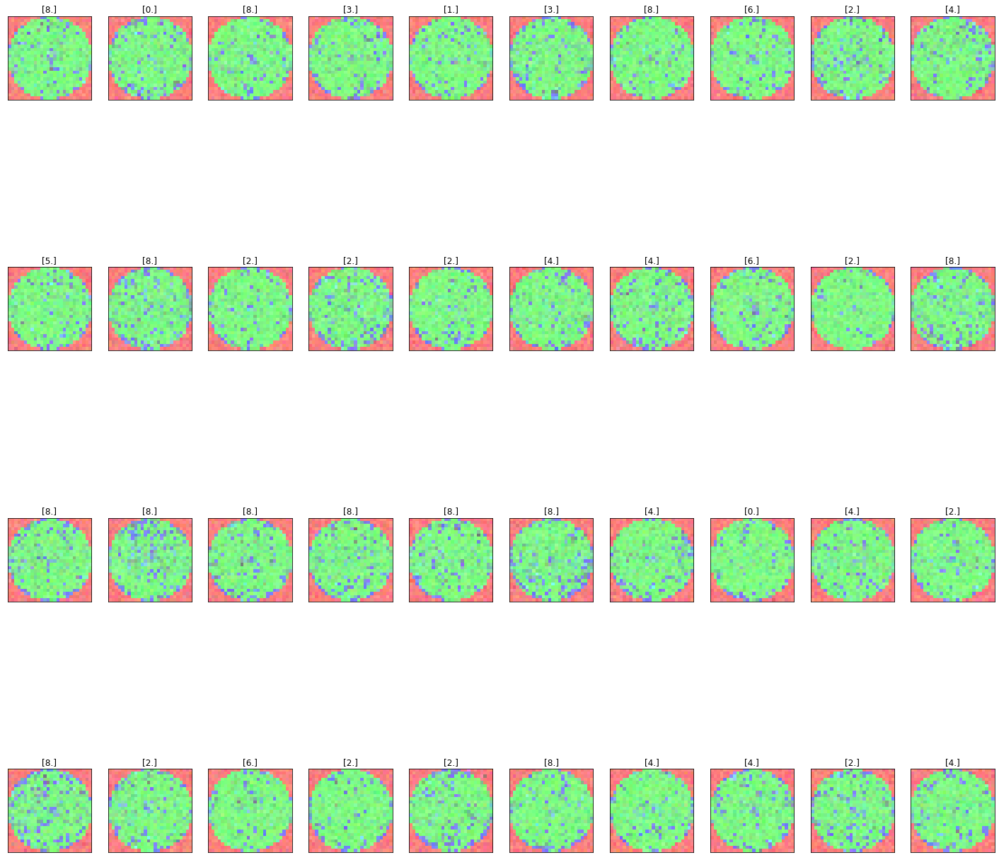

In [112]:
# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(25, 25))
# display 20 images
for idx in range(40):
    ax = fig.add_subplot(4, 10, idx+1, xticks=[], yticks=[])#subplot行數,subplot列數,每張圖顯示
    imshow2(data_test[idx])
    ax.set_title(label_test[idx])  

/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1639: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:36: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:43: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each a

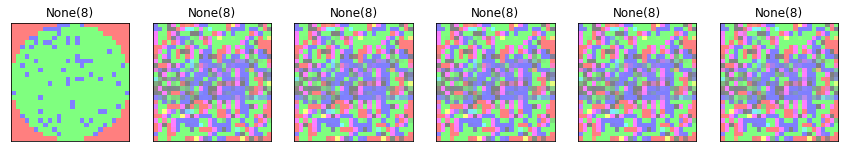

In [ ]:
train_data=[]
sum_data=[]
for i in range(1280):
  train_data.append([data_th[i],label_th[i]])
  dataloaderclass = torch.utils.data.DataLoader(train_data,batch_size=1281,num_workers=num_workers) #將data和label儲存再一起

for i in range(6405):
  sum_data.append([data_5th[i],label_5th[i]])
  reconstructloaderclsss = torch.utils.data.DataLoader(sum_data,batch_size=6405,num_workers=num_workers)

image_show, label_show = iter(dataloaderclass).next()
image_show1, label_show1 = iter(reconstructloaderclsss).next()

label_logtest=[]

for idx in range(1280):
   label_logtest.append(classes[label_show[idx]])
   idx=idx+1 
image_class=[]
a=0
  while a<(int(1281/61)):
    dataiter = iter(dataloader)
    image3,test3= dataiter.next()#origin的資料集
    image_display3 = image3.numpy() # convert images to numpy for display
    image_log.append(image_display3)     
    
    a=a+1


def Image_val(img,images,num,model):# show reconstruct 後的5張 gaussian noise wafer圖
 
 y=0 
 image_display2=img
 with torch.no_grad():
   
    # plot the images in the batch, along with the corresponding labels
    fig = plt.figure(figsize=(25,25))
    # display 20 images
    for number in range(1280):
      if label_logtest[number]=='None(8)': #辦別class狀況,輸出相對應圖
      
          for y in range(num):
            ax = fig.add_subplot(1, 10, 1, xticks=[], yticks=[])#subplot行數,subplot列數,每張圖顯示
            imshow2(image_display2[number])#生成原圖  
            ax.set_title(classes[label_show[number]])
            images = model(images.float())
            add_noise(images,(y+1)/10)#對五張生成圖做gaussian noise
            image_display = images.numpy() # convert images to numpy for display 
            y=y+1
            ax = fig.add_subplot(1, 10, y+1, xticks=[], yticks=[])#subplot行數,subplot列數,每張圖顯示
            imshow2(image_display[number])#生成五張重塑後的圖
            ax.set_title(classes[label_show[number]])
          number=number+1



Image_val(image_show,image_show,5,model)